<a href="https://colab.research.google.com/github/Anushkaghei/Underwater-Image-dehazing/blob/main/CycleGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Copy Data From Drive**

In [1]:
!pip install google-colab

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 7.0 MB/s eta 0:00:00


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# needed libraries
import re
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Conv2D, Conv2DTranspose
from tensorflow.keras.layers import Flatten, Reshape, Dropout, BatchNormalization, Activation, LeakyReLU

# VGG16
from keras.applications.vgg16 import VGG16

# utilities
import os
from glob import glob
import matplotlib.pyplot as plt
import pathlib
import time
import datetime

from IPython import display
from tqdm.auto import tqdm

from google_drive_downloader import GoogleDriveDownloader as gdd

gpu_available = tf.config.list_physical_devices('GPU')
print(gpu_available)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


# Download and Read Data

In [4]:
!cp -r '/content/drive/MyDrive/data/trainA' '/content/trainA'
!cp -r '/content/drive/MyDrive/data/trainB' '/content/trainB'
!cp -r '/content/drive/MyDrive/data/test'   '/content/test'

Define the dataset path and input dimension

In [5]:
DATA_FOLDER = '/content/trainA'
INPUT_DIM     = (256,256,3)

In [6]:
filenames  = np.array(glob(os.path.join(DATA_FOLDER, '*.png')))
n_images        = filenames.shape[0]

train_size = int(0.8 * n_images)
test_size = n_images - train_size

print('num image files : ', n_images)
print('train size : ', train_size)
print('test size : ', test_size)
print('total: ', train_size + test_size)

num image files :  890
train size :  712
test size :  178
total:  890


# Utilities to Preprocess Dataset

We define utility functions to read the images. Each input of the network has the following form

<br>
$$(Input \; Image, \; Unpaired \; Image, \; Reference \; Image)$$

<br>

<div style="text-align: justify"> where $Input \; Image$ is an image from the 'hazed' underwater dataset, $Unpaired \; Image$ is an image from the 'dehazed' underwater dataset (codomain) and $Reference \; Image$ is a high quality dehazed imagen version of the $Input \; Image$. </div>

<br>

<div style="text-align: justify"> We also use a data augmentation process in which we take random crops of random sizes from the images and then resize them to the $256 \times 256$ input size of the network, very similar to the process described in the reference paper mentioned above. The idea of the data augmentation process is to make the model learn different scales of representation of the data. </div>



In [7]:
import numpy as np
import cv2

# normalize an image
def normalize(img):
  img = (img / 127.5) - 1
  return img

def dataAugmentation(img, n_crops=2):
  height, width, channels = img.shape
  crop_list = []

  for _ in range(n_crops):
    x, y = np.random.randint(0, 256-32, 2)
    rand_height, rand_width = 256, 256

    while rand_height + x >= 256 and rand_width + y >= 256:
      rand_height, rand_width = np.random.randint(32, 160, 2)

    crop = img[y:y + rand_height, x:x + rand_width, :]
    crop = tf.image.resize(crop, (256, 256))
    crop = tf.expand_dims(crop, axis=0)
    crop_list.append(crop)

  return crop_list


def getUnpairedImages(raw_image_path, ref_image_path, u_image_path):


  raw_image = tf.io.read_file(raw_image_path)
  raw_image = tf.image.decode_png(raw_image)
  raw_image = tf.image.resize(raw_image, (256, 256))

  ref_image = tf.io.read_file(ref_image_path)
  ref_image = tf.image.decode_png(ref_image)
  ref_image = tf.image.resize(ref_image, (256, 256))

  u_image = tf.io.read_file(u_image_path)
  u_image = tf.image.decode_png(u_image)
  u_image = tf.image.resize(u_image, (256, 256))

  # Convert both images to float32 tensors
  raw_image = tf.cast(tf.identity(raw_image), tf.float32)
  ref_image = tf.cast(tf.identity(ref_image), tf.float32)
  u_image = tf.cast(tf.identity(u_image), tf.float32)

  raw_image = normalize(raw_image)
  ref_image = normalize(ref_image)
  u_image = normalize(u_image)

  return [tf.expand_dims(raw_image, axis=0), tf.expand_dims(ref_image, axis=0), tf.expand_dims(u_image, axis=0)]

def getChallengeImg(raw_image_path):
  raw_image = tf.io.read_file(raw_image_path)
  raw_image = tf.image.decode_png(raw_image)
  raw_image = tf.image.resize(raw_image, (256, 256))

  # Convert both images to float32 tensors
  raw_image = tf.cast(tf.identity(raw_image), tf.float32)

  raw_image = normalize(raw_image)

  return tf.expand_dims(raw_image, axis=0)

In [8]:
def deNormalize(img):
  img = (img + 1)* 0.5
  return img

def getRange(img):
  return np.min(img), np.max(img)

# Build Dataset

Next we have the input pipeline of the data. Data filenames from the 'raw' dataset are retrieved and paired with their high resolution 'reference' image.

In [9]:
RAW_DATA_FOLDER   = '/content/trainA'
REF_DATA_FOLDER   = '/content/trainB'

# get paths in dataset
RAW_PATH  = pathlib.Path(RAW_DATA_FOLDER)
REF_PATH  = pathlib.Path(REF_DATA_FOLDER)
raw_dataset = tf.data.Dataset.list_files(str(RAW_PATH / '*.png'), shuffle=False)
ref_dataset = tf.data.Dataset.list_files(str(REF_PATH / '*.png'), shuffle=False)
unpair_dataset = tf.data.Dataset.list_files(str(REF_PATH / '*.png'), shuffle=True)

dataset = tf.data.Dataset.zip((raw_dataset, ref_dataset, unpair_dataset))
dataset = dataset.shuffle(100)

In [10]:
AUTOTUNE = tf.data.AUTOTUNE

# get train and test dataset
train_ds = dataset.take(train_size)
test_ds = dataset.skip(train_size)

# add layer to read original and scratched image
train_ds = train_ds.map(lambda x, y, z: tf.numpy_function(func=getUnpairedImages, inp=[x, y, z], Tout=((tf.float32, tf.float32, tf.float32))), num_parallel_calls=AUTOTUNE)
test_ds = test_ds.map(lambda x, y, z: tf.numpy_function(func=getUnpairedImages, inp=[x, y, z], Tout=(tf.float32, tf.float32, tf.float32)), num_parallel_calls=AUTOTUNE)

In [11]:
RAW_DATA_FOLDER   = '/content/test'

# get paths in dataset
RAW_PATH  = pathlib.Path(RAW_DATA_FOLDER)
chall_raw_dataset = tf.data.Dataset.list_files(str(RAW_PATH / '*.png'), shuffle=False)

AUTOTUNE = tf.data.AUTOTUNE

# add layer to read original and scratched image
chall_test_ds = chall_raw_dataset.map(lambda x: tf.numpy_function(func=getChallengeImg, inp=[x], Tout=(tf.float32)), num_parallel_calls=AUTOTUNE)

<h2> Visualize Images From Dataset </h2>

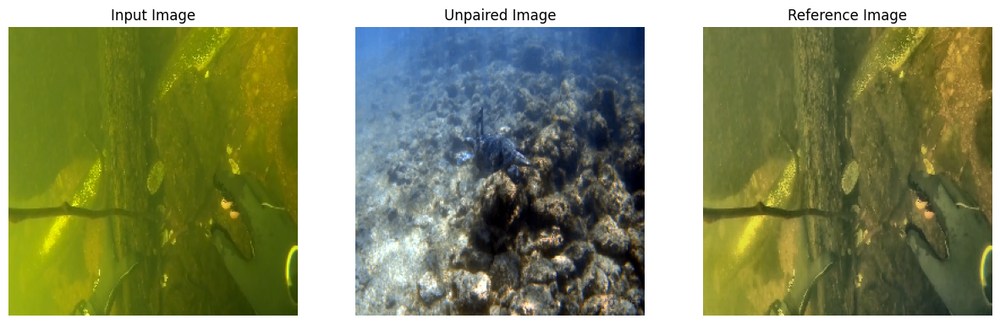

In [12]:
# try dataset
datatmp = train_ds.take(1)
data = list(datatmp)
inp, tar = data[0][0], data[0][1]

plt.figure(figsize=(15, 15))
display_list = [data[0][0], data[0][2], data[0][1]]
title = ['Input Image', 'Unpaired Image', 'Reference Image']

for i in range(3):
  plt.subplot(1, 3, i+1)
  plt.title(title[i])
  # Getting the pixel values in the [0, 1] range to plot.
  plt.imshow(display_list[i][0]* 0.5 + 0.5)
  plt.axis('off')
plt.show()

<h2> Visualize Crops </h2>

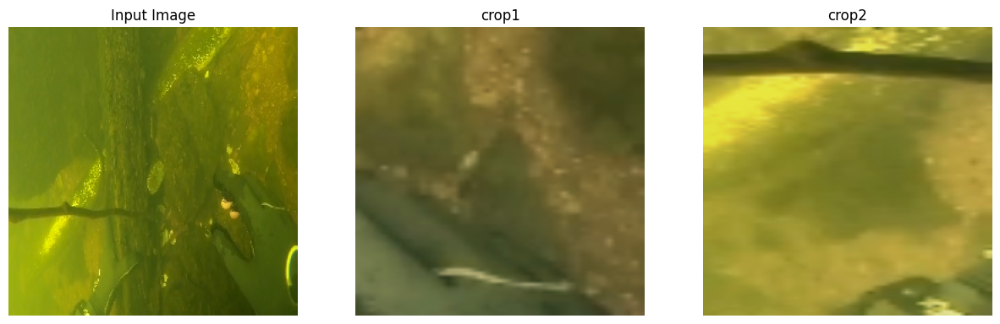

In [13]:
inp_crops = dataAugmentation(tar[0], 2)
plt.figure(figsize=(15, 15))
display_list = [inp[0], inp_crops[0][0], inp_crops[1][0]]
title = ['Input Image', 'crop1', 'crop2']
for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i]* 0.5 + 0.5)
    plt.axis('off')
plt.show()

# Network Architecture

In [14]:
OUTPUT_CHANNELS = 3

<h2> Encoder </h2>

The encoder is based on a convolutional layer follow from a  Batch Normalization and finally a LeakyReLU as activation. The encoder layer can also use an ReLU as activation.

In [15]:
def downsample(filters, size, apply_batchnorm=True, strides=2, padding='same', activation='LeakyReLU'):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=strides, padding=padding,
                             use_bias=True))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  if activation == 'ReLU':
    result.add(tf.keras.layers.ReLU())
  elif activation == 'LeakyReLU':
    result.add(tf.keras.layers.LeakyReLU())

  return result

<h2> Decoder </h2>

The decoder in the other hand is made by a transposed convolution (known as deconvolution) followed by a Batch Normalization layer and finally a ReLU activation.

In [16]:
def upsample(filters, size, strides=2, padding='same', use_activation=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=strides,
                                    padding=padding,
                                    use_bias=True))

  result.add(tf.keras.layers.BatchNormalization())

  if use_activation:
    result.add(tf.keras.layers.ReLU())

  return result

Residual blocks basically consist of two encoder layers one following the other where the first one uses a ReLU activation and the second has no activation function, i.e identity activation.  

In [17]:
def resisudal_block(filters, size):
  result = tf.keras.Sequential()
  result.add(downsample(filters, size, strides=1, activation='ReLU'))
  result.add(downsample(filters, size, strides=1, activation='None'))

  return result

<h2> Generator </h2>

The Generator of the cycleGAN consist of several stacked encoder layers follow by 6 residual blocks and finally several stacked decoder layers. As activation function of the Generator a  $tanh(x)$ function is used to retrieve values from $[-1, 1]$ and then this values are scaled to the [0, 1] values admitted by images.

In [18]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(32, 7, strides=1, activation='ReLU'),   # (batch_size, 256, 256, 32)
    downsample(64, 3, activation='ReLU'),              # (batch_size, 128, 128, 64)
    downsample(128, 3, activation='ReLU'),             # (batch_size, 64, 64, 128)
  ]

  res_blocks = [
    resisudal_block(128, 3),        # (batch_size, 64, 64, 128)
    resisudal_block(128, 3),        # (batch_size, 64, 64, 128)
    resisudal_block(128, 3),        # (batch_size, 64, 64, 128)
    resisudal_block(128, 3),        # (batch_size, 64, 64, 128)
    resisudal_block(128, 3),        # (batch_size, 64, 64, 128)
    resisudal_block(128, 3)         # (batch_size, 64, 64, 128)
  ]

  up_stack = [
    upsample(64, 3, strides=2, padding='same'),        # (batch_size, 128, 128, 64)
    upsample(32, 3, strides=2, padding='same'),        # (batch_size, 256, 256, 32)
    downsample(3, 7, strides=1, activation='None'),    # (batch_size, 256, 256, 3)
  ]

  last = tf.keras.layers.Activation(tf.keras.activations.tanh)
  x = inputs

  # Downsampling through the model
  for down in down_stack:
    x = down(x)

  # residual blocks
  for res_block in res_blocks:
    x = keras.layers.Add()([x, res_block(x)])

  # Upsampling and establishing the skip connections
  for up in up_stack:
    x = up(x)

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

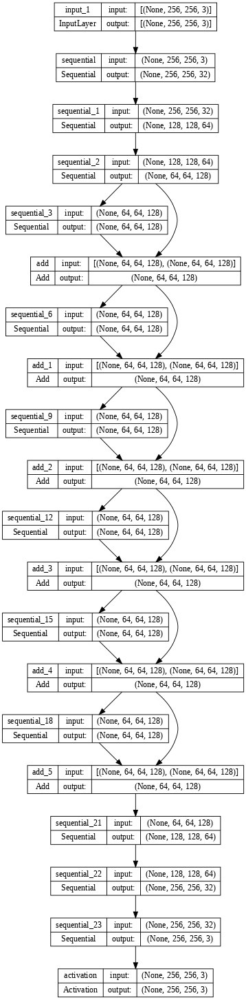

In [19]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

(-1.0, 1.0)


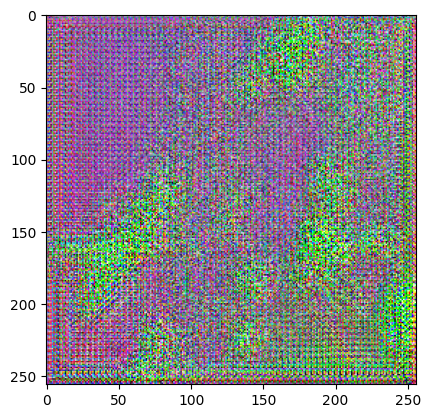

In [20]:
gen_output = generator(inp, training=True)
print(getRange(gen_output))
img_out = deNormalize(gen_output[0])
plt.imshow(img_out)

<h2> Loss Object used by the Generator</h2>

In [21]:
#loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
loss_object = tf.keras.losses.MeanSquaredError()
l1_loss = keras.losses.MeanAbsoluteError()

In [22]:
def generator_loss(disc_generated_output):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)
  return gan_loss

<h2> Discriminator </h2>

as a discriminator a PatchGAN that takes $70 \times 70$ overlapping patches of time image is used.

In [23]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')

  down1 = downsample(64, 4, False)(inp)   # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)       # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)       # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=True)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp], outputs=last)

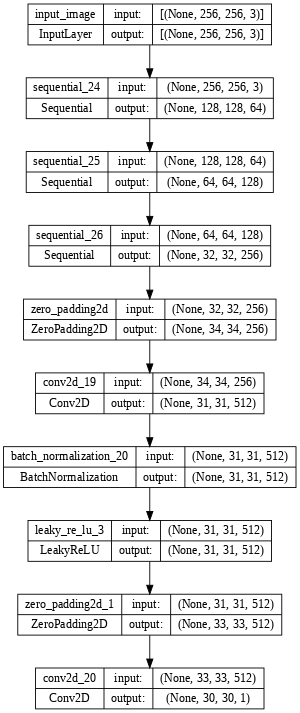

In [24]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

(-4.8532248, 5.119276)


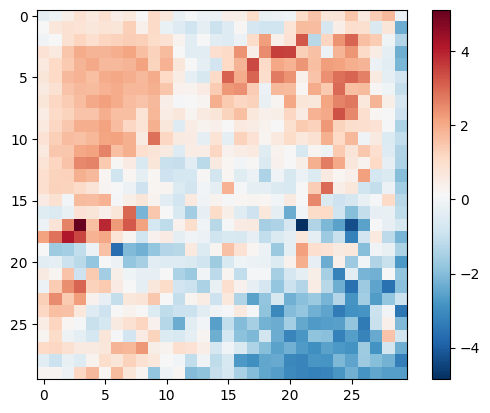

In [25]:
disc_out = discriminator([inp], training=True)
print(getRange(disc_out))
plt.imshow(disc_out[0, ..., -1], cmap='RdBu_r')
plt.colorbar()

<h2> Define Discriminator Loss</h2>

In [26]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

# CycleGAN Loss functions

<h2> Cycle Consistency Loss </h2>

As described in the paper, there are extra loss functions used by a CycleGAN, one of them is the cycle consistency loss which aims to push the generators of the cycleGAN to be able to retrieve the original image once it is passed by both generators, i.e

$$G(F(x)) = x $$

where $F$ and $G$ are the generators that map from the 'hazed' space to the 'dehazed' space and viceversa.   

In [27]:
def cycle_loss(F_G_x, G_F_y, x, y):
  loss_x = l1_loss(F_G_x, x)
  loss_y = l1_loss(G_F_y, y)

  return loss_x + loss_y


# VGG16 Features Extractor

Aditionally to the Cycle Consistency Loss, a feature loss named perceptual loss is also calculated to enhance the similarity of the output image with the 'dehazed' space in a features space. Therefore, the VGG16 $2nd$ and $5th$ pooling layers are used with this purpose.

In [28]:
vgg16 = VGG16()

553467096/553467096 [==============================] - 6s 0us/step


In [29]:
vgg16.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [30]:
def getFeaturesExtractor():
  input = keras.layers.Input([256, 256, 3])

  x = keras.layers.Resizing(
    224, 224, interpolation="bilinear", crop_to_aspect_ratio=False, name='resize')(input)

  for layer in vgg16.layers:
    layer.trainable = False

  for layer in vgg16.layers[1:]:
    x = layer(x)

    if layer.name == 'block2_pool':
      print('getting pool in block2')
      block2 = x

    if layer.name == 'block5_pool':
      print('getting pool in block5')
      block5 = x
      break

  FB2 = keras.Model(inputs=input, outputs=block2)
  FB5 = keras.Model(inputs=input, outputs=block5)

  return FB2, FB5

# Perceptual Loss

In [31]:
def get_perceptual_loss(feat_real_img, feat_decoded_img):
  return loss_object(feat_real_img, feat_decoded_img)

# Build Model

In [32]:
genG = Generator()
genF = Generator()
discX = Discriminator()
discY = Discriminator()
FeatBlock2, FeatBlock5 = getFeaturesExtractor()

getting pool in block2
getting pool in block5


In [33]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# Generate Images

For image generation the trained $G$ generator is applied to 'raw' underwater images to obtain 'reference' underwater images. To obtain high resolution images the laplacian pyramid upscaling process is used. The gaussian pyramid is constructed for both the output of generator $G$ image and the original image. Then Laplacian pyramid is constructed for the original image and before doing the Laplacian upscailing, the top level of the built Laplacian pyramid is modified with the top level of the reference gaussian pyramid (the gaussian pyramid constructed for the output of generator $G$) and after that the Laplacian upscailing process is done as regular.

In [34]:
def get_gaussian_pyramid(img):
  gauss_pyramid = [img]
  height, width, channels = img.shape

  while height > 8:
    height //= 2
    width //= 2
    img = cv2.pyrDown(img, dstsize=(height, width))
    gauss_pyramid.append(img)

  return gauss_pyramid


In [35]:
def LaplacianUpscaling(dehaze_image, hr_hazed_image, wg_Ik=1.0, wg_gauss=0.0):
  deh_gauss_pyr = get_gaussian_pyramid(dehaze_image)
  hr_srcImg_pyr = get_gaussian_pyramid(hr_hazed_image)
  laplacian_pyr = []

  # compute laplacian pyramid
  for i in range(len(hr_srcImg_pyr) - 1):
    height, width, channels = hr_srcImg_pyr[i].shape
    laplacian_pyr.append(hr_srcImg_pyr[i] - cv2.pyrUp(hr_srcImg_pyr[i+1], dstsize=(height, width)))

  Ik = deh_gauss_pyr[-1]

  height_dest, width_dest, channels_dest = Ik.shape

  # upscale image
  while height_dest < 256:
    height_dest *= 2
    width_dest *= 2
    Ik = cv2.pyrUp(wg_Ik * Ik + wg_gauss * deh_gauss_pyr[-1], dstsize=(height_dest, width_dest)) + laplacian_pyr[-1]
    laplacian_pyr.pop(-1)
    deh_gauss_pyr.pop(-1)

  return Ik


In [36]:
def generate_images(model, test_input, tar, lap_up=True, wg_Ik=1.0, wg_gauss=0.0):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  hr_img = LaplacianUpscaling(prediction[0].numpy(), test_input[0].numpy(), wg_Ik, wg_gauss) if lap_up else prediction[0]

  display_list = [test_input[0], hr_img, tar[0]]
  title = ['Input Image', 'Predicted Image', 'Reference Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i]* 0.5 + 0.5)
    plt.axis('off')
  plt.show()


# Train

we train the network by two steps, in the even epochs we train the Discriminators and in the odd epochs we train the Generators.

In [37]:
LAMBDA = 0.0001

# Train with data Augmentation

In [38]:
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

@tf.function
def disc_train_step(input_image, u_image, step):
    with tf.GradientTape() as discX_tape, tf.GradientTape() as discY_tape:
        G_x = genG(input_image, training=True)
        F_y = genF(u_image, training=True)

        D_F_y = discX(F_y, training=True)
        D_G_x = discY(G_x, training=True)

        D_x = discX(input_image, training=True)
        D_y = discY(u_image, training=True)

        discX_loss = discriminator_loss(D_x, D_F_y)
        discY_loss = discriminator_loss(D_y, D_G_x)

    discX_grads = discX_tape.gradient(discX_loss, discX.trainable_variables)
    discY_grads = discY_tape.gradient(discY_loss, discY.trainable_variables)

    # Concatenate trainable variables
    all_disc_variables = discX.trainable_variables + discY.trainable_variables

    # Apply gradients to the concatenated variables
    discriminator_optimizer.apply_gradients(zip(discX_grads + discY_grads, all_disc_variables))

    return discX_loss, discY_loss


In [39]:
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

@tf.function
def generator_train_step(input_image, u_image, step):
    with tf.GradientTape() as genG_tape, tf.GradientTape() as genF_tape:
        G_x = genG(input_image, training=True)
        F_y = genF(u_image, training=True)

        D_F_y = discX(F_y, training=True)
        D_G_x = discY(G_x, training=True)

        genG_loss = generator_loss(D_G_x)
        genF_loss = generator_loss(D_F_y)

    # Combine the trainable variables of both generators
    all_gen_variables = genG.trainable_variables + genF.trainable_variables

    genG_grads = genG_tape.gradient(genG_loss, all_gen_variables)
    genF_grads = genF_tape.gradient(genF_loss, all_gen_variables)

    generator_optimizer.apply_gradients(zip(genG_grads, genG.trainable_variables))
    if len(genF_grads) > len(genF.trainable_variables):
      genF_grads = genF_grads[:len(genF.trainable_variables)]
    elif len(genF_grads) < len(genF.trainable_variables):
      for _ in range(len(genF.trainable_variables) - len(genF_grads)):
        genF_grads.append(None)
    return genG_loss, genF_loss


Epoch:  0


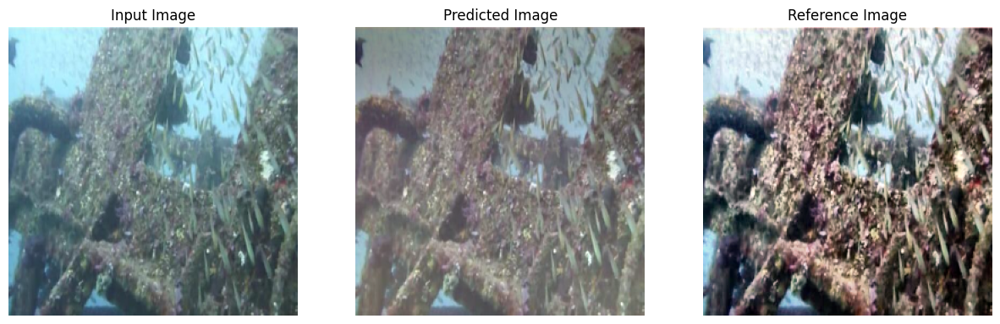

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.04520607>, <tf.Tensor: shape=(), dtype=float32, numpy=0.1902432>, <tf.Tensor: shape=(), dtype=float32, numpy=0.032191545>, <tf.Tensor: shape=(), dtype=float32, numpy=0.09738019>, <tf.Tensor: shape=(), dtype=float32, numpy=0.041947648>, <tf.Tensor: shape=(), dtype=float32, numpy=0.11549984>, <tf.Tensor: shape=(), dtype=float32, numpy=0.030946344>, <tf.Tensor: shape=(), dtype=float32, numpy=0.034257896>, <tf.Tensor: shape=(), dtype=float32, numpy=0.028052423>, <tf.Tensor: shape=(), dtype=float32, numpy=0.061666116>, <tf.Tensor: shape=(), dtype=float32, numpy=0.061554786>, <tf.Tensor: shape=(), dtype=float32, numpy=0.053163476>, <tf.Tensor: shape=(), dtype=float32, numpy=0.06447109>, <tf.Tensor: shape=(), dtype=float32, numpy=0.04914266>, <tf.Tensor: shape=(), dtype=float32, numpy=0.117913455>, <tf.Tensor: shape=(), dtype=float32, numpy=0.09680277>, <tf.Tensor: shape=(), dtype=float32, numpy=0.19730595>, <tf.Tensor: shape=(), dty

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=1.1710163>, <tf.Tensor: shape=(), dtype=float32, numpy=0.27048886>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01744463>, <tf.Tensor: shape=(), dtype=float32, numpy=0.023709467>, <tf.Tensor: shape=(), dtype=float32, numpy=0.017558724>, <tf.Tensor: shape=(), dtype=float32, numpy=0.027100584>, <tf.Tensor: shape=(), dtype=float32, numpy=0.026728619>, <tf.Tensor: shape=(), dtype=float32, numpy=0.019656992>, <tf.Tensor: shape=(), dtype=float32, numpy=0.023485644>, <tf.Tensor: shape=(), dtype=float32, numpy=0.016273333>, <tf.Tensor: shape=(), dtype=float32, numpy=0.016732901>, <tf.Tensor: shape=(), dtype=float32, numpy=0.015886096>, <tf.Tensor: shape=(), dtype=float32, numpy=0.016785381>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01939617>, <tf.Tensor: shape=(), dtype=float32, numpy=0.015829634>, <tf.Tensor: shape=(), dtype=float32, numpy=0.013891725>, <tf.Tensor: shape=(), dtype=float32, numpy=0.014163933>, <tf.Tensor: shape=(), 

[<tf.Tensor: shape=(), dtype=float32, numpy=1.0934312>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0929568>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0362757>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0618981>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0626869>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0803053>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0536331>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0896615>, <tf.Tensor: shape=(), dtype=float32, numpy=1.096711>, <tf.Tensor: shape=(), dtype=float32, numpy=1.1115633>, <tf.Tensor: shape=(), dtype=float32, numpy=1.004611>, <tf.Tensor: shape=(), dtype=float32, numpy=1.1100773>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0609493>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0858924>, <tf.Tensor: shape=(), dtype=float32, numpy=1.1015022>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0995572>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0981518>, <tf.Tensor: shape=(), dtype=float32, numpy=1.1065437>, <tf.Tensor:

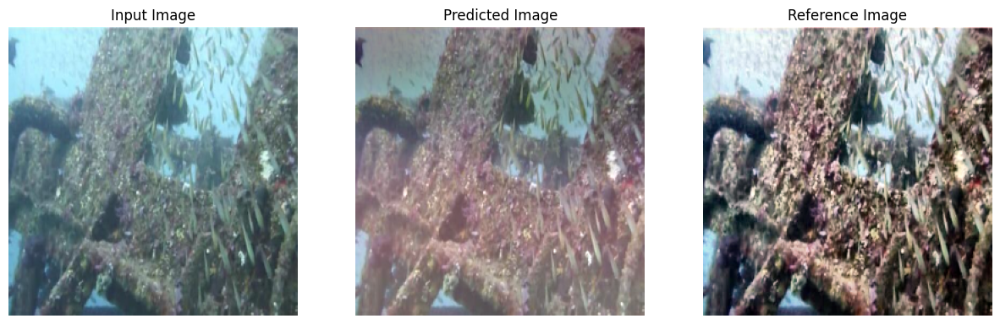

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.032759335>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0326301>, <tf.Tensor: shape=(), dtype=float32, numpy=0.015157174>, <tf.Tensor: shape=(), dtype=float32, numpy=0.017963508>, <tf.Tensor: shape=(), dtype=float32, numpy=0.014669456>, <tf.Tensor: shape=(), dtype=float32, numpy=0.025808122>, <tf.Tensor: shape=(), dtype=float32, numpy=0.013411688>, <tf.Tensor: shape=(), dtype=float32, numpy=0.012872189>, <tf.Tensor: shape=(), dtype=float32, numpy=0.034370378>, <tf.Tensor: shape=(), dtype=float32, numpy=0.031191368>, <tf.Tensor: shape=(), dtype=float32, numpy=0.009806032>, <tf.Tensor: shape=(), dtype=float32, numpy=0.018742314>, <tf.Tensor: shape=(), dtype=float32, numpy=0.020873472>, <tf.Tensor: shape=(), dtype=float32, numpy=0.017767565>, <tf.Tensor: shape=(), dtype=float32, numpy=0.019448437>, <tf.Tensor: shape=(), dtype=float32, numpy=0.023271851>, <tf.Tensor: shape=(), dtype=float32, numpy=0.010395838>, <tf.Tensor: shape=

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.9267545>, <tf.Tensor: shape=(), dtype=float32, numpy=0.289892>, <tf.Tensor: shape=(), dtype=float32, numpy=0.018935384>, <tf.Tensor: shape=(), dtype=float32, numpy=0.02085157>, <tf.Tensor: shape=(), dtype=float32, numpy=0.010614885>, <tf.Tensor: shape=(), dtype=float32, numpy=0.012424921>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01671863>, <tf.Tensor: shape=(), dtype=float32, numpy=0.021144344>, <tf.Tensor: shape=(), dtype=float32, numpy=0.012181725>, <tf.Tensor: shape=(), dtype=float32, numpy=0.012264964>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01360697>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01233591>, <tf.Tensor: shape=(), dtype=float32, numpy=0.020241357>, <tf.Tensor: shape=(), dtype=float32, numpy=0.013491295>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0136726415>, <tf.Tensor: shape=(), dtype=float32, numpy=0.012328816>, <tf.Tensor: shape=(), dtype=float32, numpy=0.016379088>, <tf.Tensor: shape=(), dty

[<tf.Tensor: shape=(), dtype=float32, numpy=0.93992704>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9639684>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9535494>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9498212>, <tf.Tensor: shape=(), dtype=float32, numpy=0.95333254>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9445441>, <tf.Tensor: shape=(), dtype=float32, numpy=0.930164>, <tf.Tensor: shape=(), dtype=float32, numpy=0.95293444>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9722483>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9175931>, <tf.Tensor: shape=(), dtype=float32, numpy=0.92958796>, <tf.Tensor: shape=(), dtype=float32, numpy=0.94892824>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9494386>, <tf.Tensor: shape=(), dtype=float32, numpy=0.94947255>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9506104>, <tf.Tensor: shape=(), dtype=float32, numpy=0.94564307>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9853116>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99384683>, <t

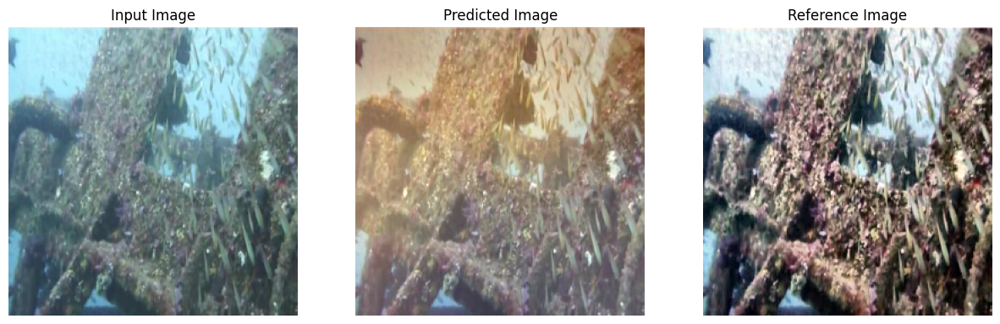

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.004541763>, <tf.Tensor: shape=(), dtype=float32, numpy=0.035816275>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01907762>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0193564>, <tf.Tensor: shape=(), dtype=float32, numpy=0.029652722>, <tf.Tensor: shape=(), dtype=float32, numpy=0.011427757>, <tf.Tensor: shape=(), dtype=float32, numpy=0.014491548>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0071436856>, <tf.Tensor: shape=(), dtype=float32, numpy=0.028237645>, <tf.Tensor: shape=(), dtype=float32, numpy=0.027793303>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0108874645>, <tf.Tensor: shape=(), dtype=float32, numpy=0.011659497>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00993825>, <tf.Tensor: shape=(), dtype=float32, numpy=0.013130444>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0076304404>, <tf.Tensor: shape=(), dtype=float32, numpy=0.024925984>, <tf.Tensor: shape=(), dtype=float32, numpy=0.03873118>, <tf.Tensor: shape=

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.9818588>, <tf.Tensor: shape=(), dtype=float32, numpy=0.33044663>, <tf.Tensor: shape=(), dtype=float32, numpy=0.018975811>, <tf.Tensor: shape=(), dtype=float32, numpy=0.015013178>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008884898>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01547301>, <tf.Tensor: shape=(), dtype=float32, numpy=0.007944286>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0094949445>, <tf.Tensor: shape=(), dtype=float32, numpy=0.011381242>, <tf.Tensor: shape=(), dtype=float32, numpy=0.009341191>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00825483>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0078967055>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00933282>, <tf.Tensor: shape=(), dtype=float32, numpy=0.011554257>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008731815>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0070208763>, <tf.Tensor: shape=(), dtype=float32, numpy=0.013993882>, <tf.Tensor: shape=()

[<tf.Tensor: shape=(), dtype=float32, numpy=1.0146463>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0124695>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0220389>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0198535>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0156405>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9890386>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0355531>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0156945>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9980583>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99599123>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0029011>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0013636>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0350417>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0332847>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0112263>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0177143>, <tf.Tensor: shape=(), dtype=float32, numpy=1.024229>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0148952>, <tf.Tenso

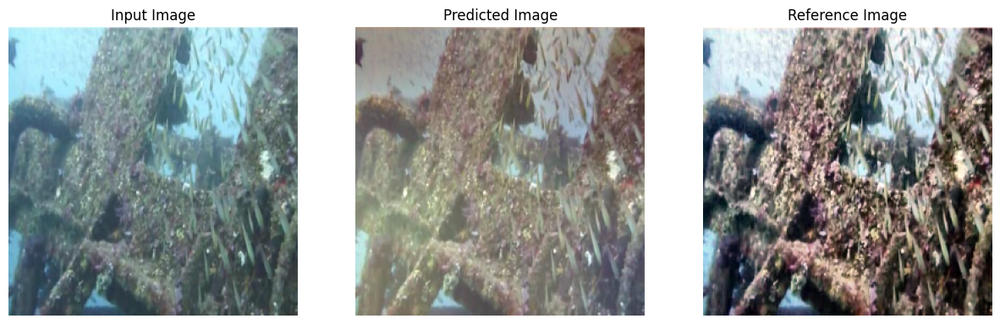

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.003275124>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0056468435>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0016976373>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005003978>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0023234678>, <tf.Tensor: shape=(), dtype=float32, numpy=0.003459711>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0030658552>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0018539409>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00357275>, <tf.Tensor: shape=(), dtype=float32, numpy=0.003485315>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0056484975>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0020716153>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0028035385>, <tf.Tensor: shape=(), dtype=float32, numpy=0.004459278>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0041819112>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0035849477>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0042010886>, <tf.Te

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.9981021>, <tf.Tensor: shape=(), dtype=float32, numpy=0.58946127>, <tf.Tensor: shape=(), dtype=float32, numpy=0.06797397>, <tf.Tensor: shape=(), dtype=float32, numpy=0.004513494>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0056454176>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0048922417>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0039631403>, <tf.Tensor: shape=(), dtype=float32, numpy=0.003810727>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005280871>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0042235223>, <tf.Tensor: shape=(), dtype=float32, numpy=0.004245386>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005286042>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0052054236>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0051744576>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005372433>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0041298144>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0048559527>, <tf.Tensor: s

[<tf.Tensor: shape=(), dtype=float32, numpy=0.95398086>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9748832>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9128102>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9494803>, <tf.Tensor: shape=(), dtype=float32, numpy=0.97461593>, <tf.Tensor: shape=(), dtype=float32, numpy=0.95679647>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9374362>, <tf.Tensor: shape=(), dtype=float32, numpy=0.94613296>, <tf.Tensor: shape=(), dtype=float32, numpy=0.95569587>, <tf.Tensor: shape=(), dtype=float32, numpy=0.96091485>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9411271>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9777498>, <tf.Tensor: shape=(), dtype=float32, numpy=0.94979763>, <tf.Tensor: shape=(), dtype=float32, numpy=0.95855576>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9605021>, <tf.Tensor: shape=(), dtype=float32, numpy=0.96345705>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9745528>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9872933>, 

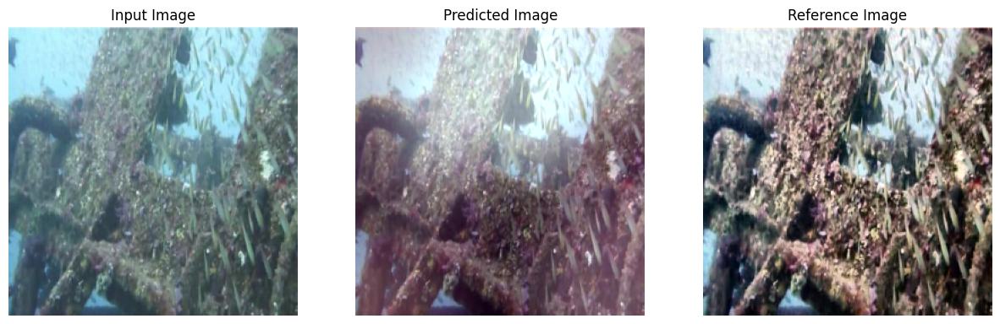

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.012463747>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0057470463>, <tf.Tensor: shape=(), dtype=float32, numpy=0.014229271>, <tf.Tensor: shape=(), dtype=float32, numpy=0.015935361>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008113905>, <tf.Tensor: shape=(), dtype=float32, numpy=0.025631309>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006971875>, <tf.Tensor: shape=(), dtype=float32, numpy=0.021231394>, <tf.Tensor: shape=(), dtype=float32, numpy=0.007469623>, <tf.Tensor: shape=(), dtype=float32, numpy=0.009361076>, <tf.Tensor: shape=(), dtype=float32, numpy=0.007747425>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006024777>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005286555>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0064976783>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0063212756>, <tf.Tensor: shape=(), dtype=float32, numpy=0.007952498>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008330144>, <tf.Tensor: s

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=1.0346262>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9504808>, <tf.Tensor: shape=(), dtype=float32, numpy=0.59484965>, <tf.Tensor: shape=(), dtype=float32, numpy=0.32130376>, <tf.Tensor: shape=(), dtype=float32, numpy=0.18422025>, <tf.Tensor: shape=(), dtype=float32, numpy=0.02271236>, <tf.Tensor: shape=(), dtype=float32, numpy=0.02115616>, <tf.Tensor: shape=(), dtype=float32, numpy=0.027414635>, <tf.Tensor: shape=(), dtype=float32, numpy=0.018136416>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01600232>, <tf.Tensor: shape=(), dtype=float32, numpy=0.020003166>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01322532>, <tf.Tensor: shape=(), dtype=float32, numpy=0.021973515>, <tf.Tensor: shape=(), dtype=float32, numpy=0.011640996>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008282313>, <tf.Tensor: shape=(), dtype=float32, numpy=0.009636046>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0116564175>, <tf.Tensor: shape=(), dtype

genG_mean_loss: 0.002570, genF_mean_loss: 0.980717
Epoch:  10


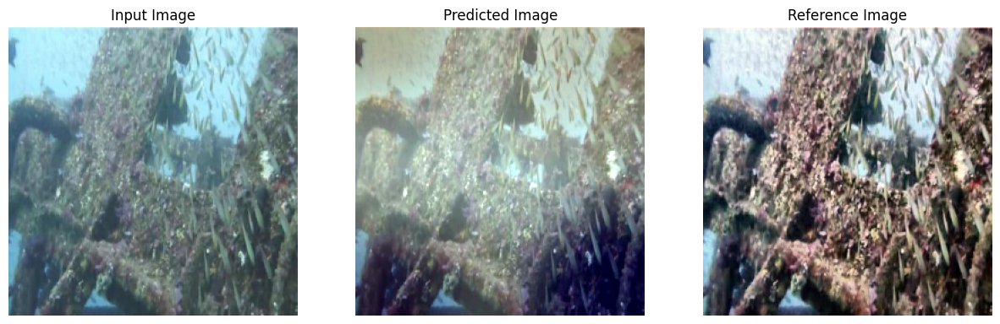

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.00047122635>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00037098388>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00036910674>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00048521126>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00050006236>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00049768656>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00040135716>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00037521566>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00064280286>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0006722716>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00092504907>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00048616753>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0009586023>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00028571681>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00070483756>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0002574703>, <tf.Tensor: shape=(), dtype=float32, numpy=0

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.8919091>, <tf.Tensor: shape=(), dtype=float32, numpy=0.67436266>, <tf.Tensor: shape=(), dtype=float32, numpy=0.2082915>, <tf.Tensor: shape=(), dtype=float32, numpy=0.033637546>, <tf.Tensor: shape=(), dtype=float32, numpy=0.011657974>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008280302>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0097185625>, <tf.Tensor: shape=(), dtype=float32, numpy=0.007838631>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0066869985>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0067378986>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006886048>, <tf.Tensor: shape=(), dtype=float32, numpy=0.007277055>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0045165643>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005604109>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0044258125>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006923457>, <tf.Tensor: shape=(), dtype=float32, numpy=0.004200191>, <tf.Tensor: shape

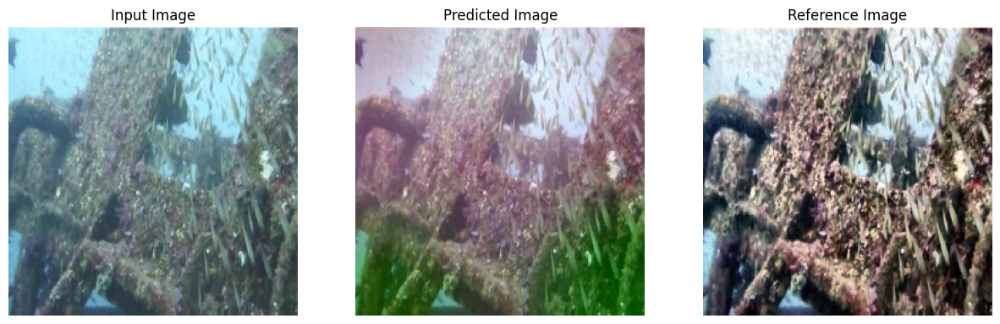

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.0005029917>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00055906305>, <tf.Tensor: shape=(), dtype=float32, numpy=0.001465932>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0008719008>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00035564954>, <tf.Tensor: shape=(), dtype=float32, numpy=0.001841963>, <tf.Tensor: shape=(), dtype=float32, numpy=0.001643157>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00037669088>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0014030756>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0014566467>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0005411412>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0013337212>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00067552086>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00046720597>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00096882955>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0009118254>, <tf.Tensor: shape=(), dtype=float32, numpy=0.000482873

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.9869651>, <tf.Tensor: shape=(), dtype=float32, numpy=0.72462493>, <tf.Tensor: shape=(), dtype=float32, numpy=0.25799945>, <tf.Tensor: shape=(), dtype=float32, numpy=0.08225459>, <tf.Tensor: shape=(), dtype=float32, numpy=0.17138761>, <tf.Tensor: shape=(), dtype=float32, numpy=0.05387232>, <tf.Tensor: shape=(), dtype=float32, numpy=0.03211555>, <tf.Tensor: shape=(), dtype=float32, numpy=0.02956258>, <tf.Tensor: shape=(), dtype=float32, numpy=0.03366064>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01862089>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01953809>, <tf.Tensor: shape=(), dtype=float32, numpy=0.02549633>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01632143>, <tf.Tensor: shape=(), dtype=float32, numpy=0.012257067>, <tf.Tensor: shape=(), dtype=float32, numpy=0.02162937>, <tf.Tensor: shape=(), dtype=float32, numpy=0.014803317>, <tf.Tensor: shape=(), dtype=float32, numpy=0.014041294>, <tf.Tensor: shape=(), dtype=floa

[<tf.Tensor: shape=(), dtype=float32, numpy=1.0010049>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9992059>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0014917>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0016083>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0014544>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0011849>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0025222>, <tf.Tensor: shape=(), dtype=float32, numpy=1.002706>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0018189>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9997127>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99568015>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0021029>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0024298>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0021651>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9992656>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99669707>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0013683>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99916804>, <tf.Ten

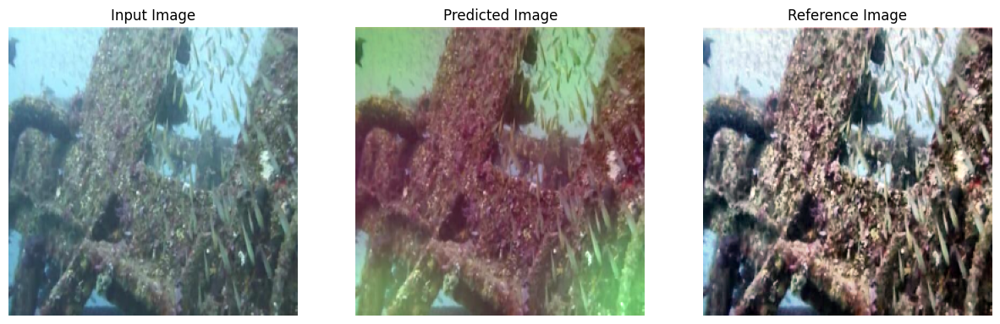

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=5.6934856e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00021461248>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0002079574>, <tf.Tensor: shape=(), dtype=float32, numpy=6.44855e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00010917537>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00013335166>, <tf.Tensor: shape=(), dtype=float32, numpy=5.80694e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=8.158996e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=8.1374674e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=6.52214e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00012334176>, <tf.Tensor: shape=(), dtype=float32, numpy=4.6981404e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00013633244>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0001787252>, <tf.Tensor: shape=(), dtype=float32, numpy=6.2201485e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00023172138>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00032

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=1.0126863>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0238017>, <tf.Tensor: shape=(), dtype=float32, numpy=0.6188867>, <tf.Tensor: shape=(), dtype=float32, numpy=0.27017364>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0849222>, <tf.Tensor: shape=(), dtype=float32, numpy=0.04913921>, <tf.Tensor: shape=(), dtype=float32, numpy=0.043808315>, <tf.Tensor: shape=(), dtype=float32, numpy=0.016575728>, <tf.Tensor: shape=(), dtype=float32, numpy=0.014851553>, <tf.Tensor: shape=(), dtype=float32, numpy=0.020005591>, <tf.Tensor: shape=(), dtype=float32, numpy=0.010491569>, <tf.Tensor: shape=(), dtype=float32, numpy=0.010852614>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005467393>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005348493>, <tf.Tensor: shape=(), dtype=float32, numpy=0.002693593>, <tf.Tensor: shape=(), dtype=float32, numpy=0.004846132>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0028239838>, <tf.Tensor: shape=(), dtyp

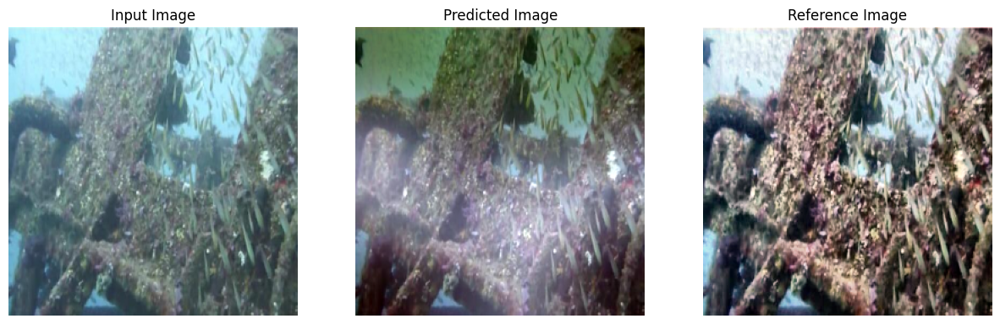

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.00014389954>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00011779872>, <tf.Tensor: shape=(), dtype=float32, numpy=1.884512e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00010550367>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0002294709>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00017381203>, <tf.Tensor: shape=(), dtype=float32, numpy=7.491125e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.5699235e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=9.225546e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=7.0979535e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=5.1518866e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=8.180096e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00010163717>, <tf.Tensor: shape=(), dtype=float32, numpy=8.011239e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3.6681406e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=5.8960486e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=4.84

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.92397517>, <tf.Tensor: shape=(), dtype=float32, numpy=0.614793>, <tf.Tensor: shape=(), dtype=float32, numpy=0.2746333>, <tf.Tensor: shape=(), dtype=float32, numpy=0.030237546>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0057115294>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0070945676>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006757565>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008669455>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0046540205>, <tf.Tensor: shape=(), dtype=float32, numpy=0.009175735>, <tf.Tensor: shape=(), dtype=float32, numpy=0.009944269>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0068612904>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0075223795>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008570715>, <tf.Tensor: shape=(), dtype=float32, numpy=0.007848465>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006246291>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006657639>, <tf.Tensor: shape=

genG_mean_loss: 0.001941, genF_mean_loss: 0.991961
Epoch:  18


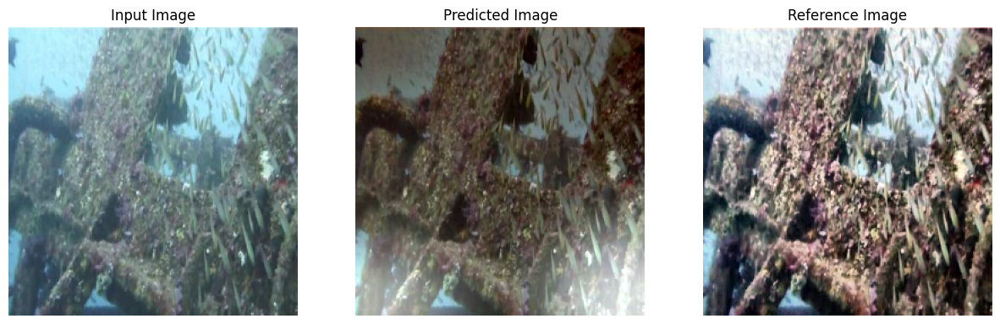

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.00013919792>, <tf.Tensor: shape=(), dtype=float32, numpy=0.000117296775>, <tf.Tensor: shape=(), dtype=float32, numpy=5.842663e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=9.995995e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=7.81292e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=5.948277e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.000102208476>, <tf.Tensor: shape=(), dtype=float32, numpy=8.2598526e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=4.5954126e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.000102031954>, <tf.Tensor: shape=(), dtype=float32, numpy=5.1301184e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=4.6930432e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=7.968568e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3.580985e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=4.889204e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=8.3514286e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.9

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=1.0229337>, <tf.Tensor: shape=(), dtype=float32, numpy=0.75692964>, <tf.Tensor: shape=(), dtype=float32, numpy=0.37295228>, <tf.Tensor: shape=(), dtype=float32, numpy=0.1336004>, <tf.Tensor: shape=(), dtype=float32, numpy=0.11035678>, <tf.Tensor: shape=(), dtype=float32, numpy=0.08048629>, <tf.Tensor: shape=(), dtype=float32, numpy=0.11046342>, <tf.Tensor: shape=(), dtype=float32, numpy=0.07443861>, <tf.Tensor: shape=(), dtype=float32, numpy=0.061795305>, <tf.Tensor: shape=(), dtype=float32, numpy=0.12773353>, <tf.Tensor: shape=(), dtype=float32, numpy=0.03393283>, <tf.Tensor: shape=(), dtype=float32, numpy=0.03980929>, <tf.Tensor: shape=(), dtype=float32, numpy=0.112511836>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0658528>, <tf.Tensor: shape=(), dtype=float32, numpy=0.05064365>, <tf.Tensor: shape=(), dtype=float32, numpy=0.028226003>, <tf.Tensor: shape=(), dtype=float32, numpy=0.029507987>, <tf.Tensor: shape=(), dtype=float

[<tf.Tensor: shape=(), dtype=float32, numpy=0.9914122>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9911858>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9916413>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9914488>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9915435>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99143726>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99073565>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9916096>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99238116>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9912021>, <tf.Tensor: shape=(), dtype=float32, numpy=0.990445>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9915117>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99168843>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9920057>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99150753>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99098825>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99069566>, <tf.Tensor: shape=(), dtype=float32, numpy=0.99092996>, <t

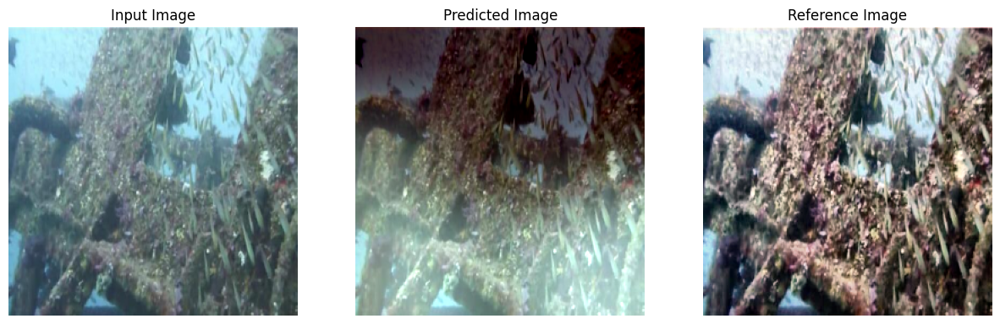

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.00018355623>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00013565127>, <tf.Tensor: shape=(), dtype=float32, numpy=4.592371e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00012409082>, <tf.Tensor: shape=(), dtype=float32, numpy=4.685815e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=7.080053e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=7.322076e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=6.189525e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=6.866368e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=9.670853e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=7.027504e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=7.655623e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=0.000100924226>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00011795936>, <tf.Tensor: shape=(), dtype=float32, numpy=8.937391e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=7.9260775e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=5.34728

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.9110924>, <tf.Tensor: shape=(), dtype=float32, numpy=0.8586968>, <tf.Tensor: shape=(), dtype=float32, numpy=0.5704985>, <tf.Tensor: shape=(), dtype=float32, numpy=0.30784282>, <tf.Tensor: shape=(), dtype=float32, numpy=0.17232513>, <tf.Tensor: shape=(), dtype=float32, numpy=0.029627627>, <tf.Tensor: shape=(), dtype=float32, numpy=0.09239204>, <tf.Tensor: shape=(), dtype=float32, numpy=0.057720236>, <tf.Tensor: shape=(), dtype=float32, numpy=0.047084704>, <tf.Tensor: shape=(), dtype=float32, numpy=0.033686835>, <tf.Tensor: shape=(), dtype=float32, numpy=0.020890392>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0117648635>, <tf.Tensor: shape=(), dtype=float32, numpy=0.013754851>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0076721893>, <tf.Tensor: shape=(), dtype=float32, numpy=0.013587789>, <tf.Tensor: shape=(), dtype=float32, numpy=0.012288503>, <tf.Tensor: shape=(), dtype=float32, numpy=0.022862788>, <tf.Tensor: shape=(), dt

genG_mean_loss: 0.004902, genF_mean_loss: 0.997591
Epoch:  22


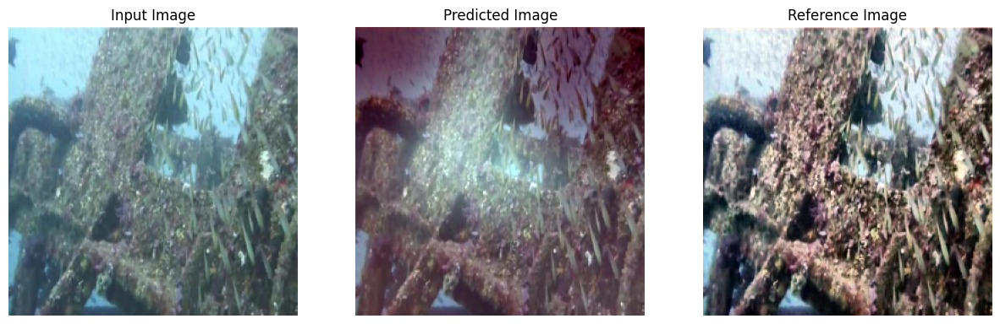

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=2.192404e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=6.267175e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=4.5447276e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.6072436e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3.285427e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3.9387363e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.1832384e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.7038807e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.6536978e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.5189185e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.1676103e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.6024856e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.1230284e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=8.556393e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=1.5159976e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.2105139e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.9201127>, <tf.Tensor: shape=(), dtype=float32, numpy=0.8573765>, <tf.Tensor: shape=(), dtype=float32, numpy=0.7303985>, <tf.Tensor: shape=(), dtype=float32, numpy=0.493713>, <tf.Tensor: shape=(), dtype=float32, numpy=0.3283839>, <tf.Tensor: shape=(), dtype=float32, numpy=0.20900048>, <tf.Tensor: shape=(), dtype=float32, numpy=0.22429915>, <tf.Tensor: shape=(), dtype=float32, numpy=0.11734663>, <tf.Tensor: shape=(), dtype=float32, numpy=0.085302174>, <tf.Tensor: shape=(), dtype=float32, numpy=0.11253516>, <tf.Tensor: shape=(), dtype=float32, numpy=0.040984612>, <tf.Tensor: shape=(), dtype=float32, numpy=0.01608912>, <tf.Tensor: shape=(), dtype=float32, numpy=0.021209354>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00565398>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0054127676>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006588696>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0053512584>, <tf.Tensor: shape=(), dtype=floa

genG_mean_loss: 0.002520, genF_mean_loss: 0.998859
Epoch:  24


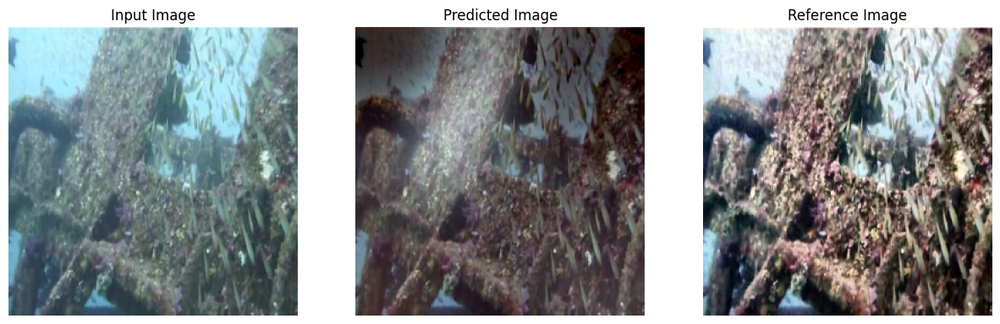

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=2.8106067e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.4388699e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.9944535e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3.7510916e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=5.052564e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.1051983e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.2902554e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3.099343e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.7815339e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.4546813e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.4212673e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3.7895803e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3.6349793e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=4.381829e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.9621602e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=4.5034776e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=0.975307>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9548331>, <tf.Tensor: shape=(), dtype=float32, numpy=0.8299011>, <tf.Tensor: shape=(), dtype=float32, numpy=0.77888507>, <tf.Tensor: shape=(), dtype=float32, numpy=0.54517084>, <tf.Tensor: shape=(), dtype=float32, numpy=0.2778622>, <tf.Tensor: shape=(), dtype=float32, numpy=0.06757943>, <tf.Tensor: shape=(), dtype=float32, numpy=0.039833713>, <tf.Tensor: shape=(), dtype=float32, numpy=0.028705211>, <tf.Tensor: shape=(), dtype=float32, numpy=0.015298489>, <tf.Tensor: shape=(), dtype=float32, numpy=0.019624813>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005451975>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006021585>, <tf.Tensor: shape=(), dtype=float32, numpy=0.005443494>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0064182393>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008629517>, <tf.Tensor: shape=(), dtype=float32, numpy=0.009177013>, <tf.Tensor: shape=(), dtype=

[<tf.Tensor: shape=(), dtype=float32, numpy=1.0008974>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0007706>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0006952>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0008705>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0008404>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0007282>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0004427>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0006977>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0001658>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0008396>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0007279>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0006318>, <tf.Tensor: shape=(), dtype=float32, numpy=1.000931>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0007852>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0007815>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0007702>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0008299>, <tf.Tensor: shape=(), dtype=float32, numpy=1.000458>, <tf.Tensor:

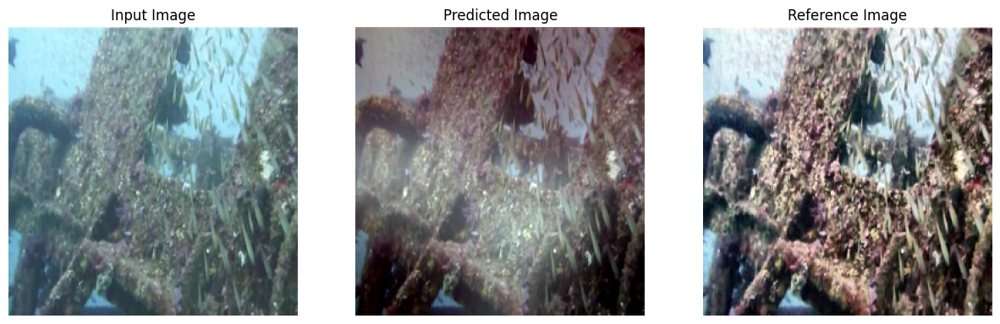

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=8.052161e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=6.2841227e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=1.2253829e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=8.18976e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=6.3745665e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=7.3120955e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=8.826123e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=5.6885347e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=2.8132213e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=6.212629e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=9.66769e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=1.5625414e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.2072895e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.3653071e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.054464e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0353022e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=9.6709

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=1.0219961>, <tf.Tensor: shape=(), dtype=float32, numpy=0.50741804>, <tf.Tensor: shape=(), dtype=float32, numpy=0.040153824>, <tf.Tensor: shape=(), dtype=float32, numpy=0.00761146>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0013950438>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0012018365>, <tf.Tensor: shape=(), dtype=float32, numpy=0.003060712>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0019872861>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0036693965>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0027490912>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0025908332>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0029863452>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0026786732>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0033928321>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0023850228>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0025022172>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0039054567>, <tf.Tenso

genG_mean_loss: 0.001522, genF_mean_loss: 0.998968
Epoch:  28


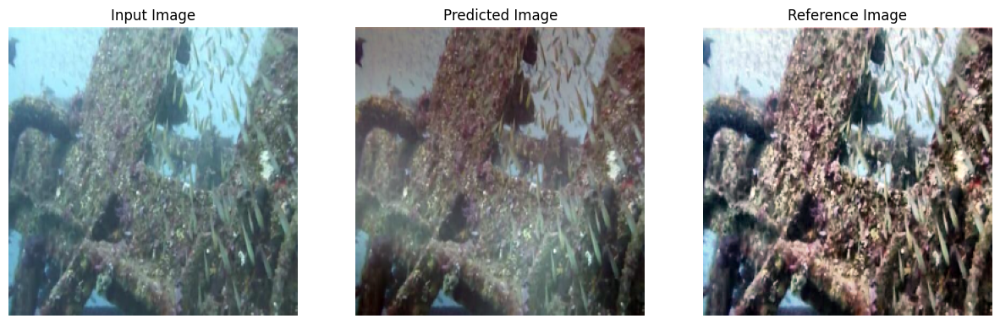

  0%|          | 0/712 [00:00<?, ?it/s]

discX losses: [<tf.Tensor: shape=(), dtype=float32, numpy=1.9549509e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=7.448054e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=2.3323351e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.3459743e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.041709e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.800976e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.3903166e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.0004709e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.5263828e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.5105347e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.1309675e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.3711408e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=2.4591443e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=3.6726262e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=1.5357493e-05>, <tf.Tensor: shape=(), dtype=float32, numpy=8.920466e-06>, <tf.Tensor: shape=(), dtype=float32, numpy=1.

  0%|          | 0/712 [00:00<?, ?it/s]

genG losses: [<tf.Tensor: shape=(), dtype=float32, numpy=1.0412358>, <tf.Tensor: shape=(), dtype=float32, numpy=0.9470746>, <tf.Tensor: shape=(), dtype=float32, numpy=0.5960915>, <tf.Tensor: shape=(), dtype=float32, numpy=0.22452739>, <tf.Tensor: shape=(), dtype=float32, numpy=0.09579609>, <tf.Tensor: shape=(), dtype=float32, numpy=0.044460747>, <tf.Tensor: shape=(), dtype=float32, numpy=0.030184781>, <tf.Tensor: shape=(), dtype=float32, numpy=0.042571466>, <tf.Tensor: shape=(), dtype=float32, numpy=0.020239994>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0152055295>, <tf.Tensor: shape=(), dtype=float32, numpy=0.012141906>, <tf.Tensor: shape=(), dtype=float32, numpy=0.011512925>, <tf.Tensor: shape=(), dtype=float32, numpy=0.009237413>, <tf.Tensor: shape=(), dtype=float32, numpy=0.007816518>, <tf.Tensor: shape=(), dtype=float32, numpy=0.008585864>, <tf.Tensor: shape=(), dtype=float32, numpy=0.010066609>, <tf.Tensor: shape=(), dtype=float32, numpy=0.006796469>, <tf.Tensor: shape=(), dt

In [43]:
def fit(train_ds, test_ds, epochs, initial_epoch=0):
    example_input, example_target, _ = next(iter(test_ds.take(1)))

    for epoch in range(initial_epoch, initial_epoch + epochs):
        print('Epoch: ', epoch)

        turn = epoch % 2
        genG_losses = []
        genF_losses = []
        discX_losses = []
        discY_losses = []

        if turn == 0:
            generate_images(genG, example_input, example_target)

        for step, (input_image, _, u_image) in tqdm(train_ds.enumerate()):
            inputs = dataAugmentation(input_image[0], n_crops=2)
            targetSpace = dataAugmentation(u_image[0], n_crops=2)
            inputs.append(input_image)
            targetSpace.append(u_image)

            for (input_image, u_image) in zip(inputs, targetSpace):
                if turn == 1:
                    genG_loss, genF_loss = generator_train_step(input_image, u_image, step)
                    genG_losses.append(genG_loss)
                    genF_losses.append(genF_loss)
                else:
                    discX_loss, discY_loss = disc_train_step(input_image, u_image, step)
                    discX_losses.append(discX_loss)
                    discY_losses.append(discY_loss)

        if turn == 1:
            print('genG losses:', genG_losses)
            print('genF losses:', genF_losses)
            genG_mean_loss = tf.math.reduce_mean(genG_losses)
            genF_mean_loss = tf.math.reduce_mean(genF_losses)
            print('genG_mean_loss: {:.6f}, genF_mean_loss: {:.6f}'.format(genG_mean_loss, genF_mean_loss))
        else:
            print('discX losses:', discX_losses)
            print('discY losses:', discY_losses)
            discX_mean_loss = tf.math.reduce_mean(discX_losses)
            discY_mean_loss = tf.math.reduce_mean(discY_losses)
            print('discX_mean_loss: {:.6f}, discY_mean_loss: {:.6f}'.format(discX_mean_loss, discY_mean_loss))


fit(train_ds, test_ds, epochs=30, initial_epoch=0)

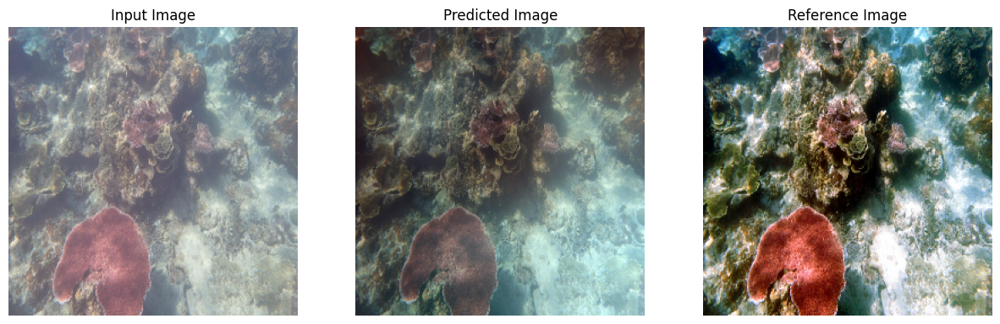

In [46]:
img, ref, uimg = list(train_ds.take(1))[0]
generate_images(genG, img, ref)

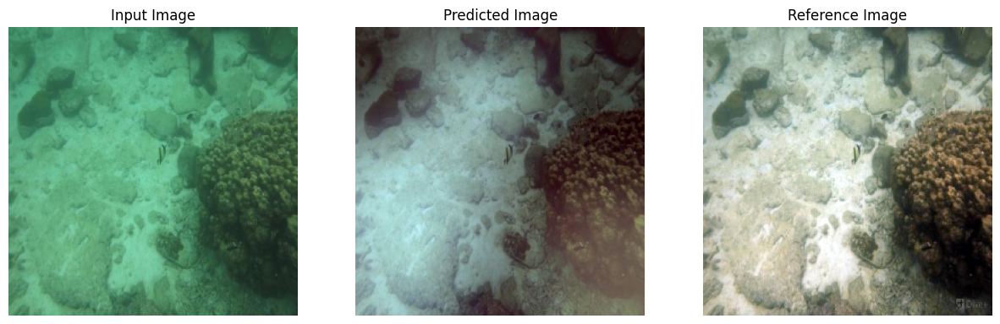

In [63]:
for example_input, example_target, _ in test_ds.take(1):
  generate_images(genG, example_input, example_target)

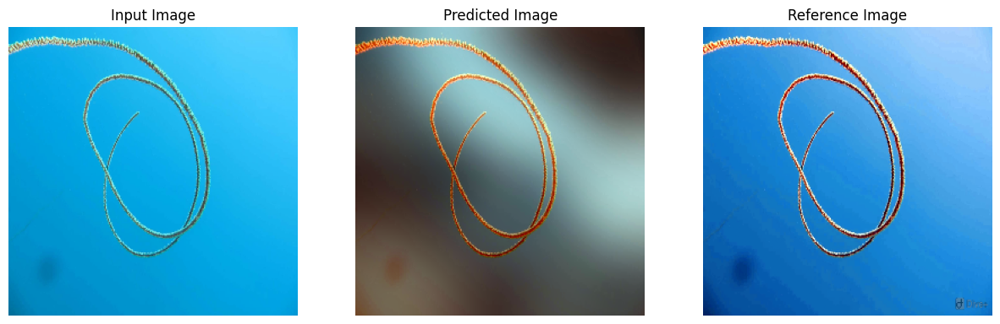

In [72]:
for example_input, example_target, _ in test_ds.take(1):
  generate_images(genG, example_input, example_target)

In the above examples we can see several results, some of them show really nice and "natural" results, but some others show images that have improven their quality but still do not get the quality of the reference images. This could be due to some reference images sometimes are shaded or look like they have a "filter" on, so this could push the network to learn incorrect features from the codomain space give the fact that the reference images are used as the codomain space.

#Testing with Challenge Dataset

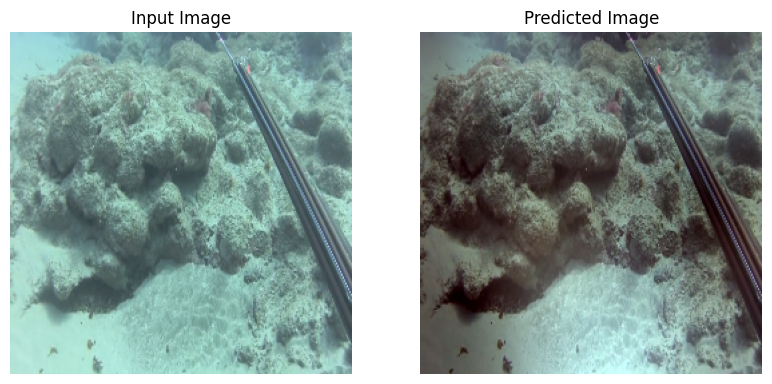

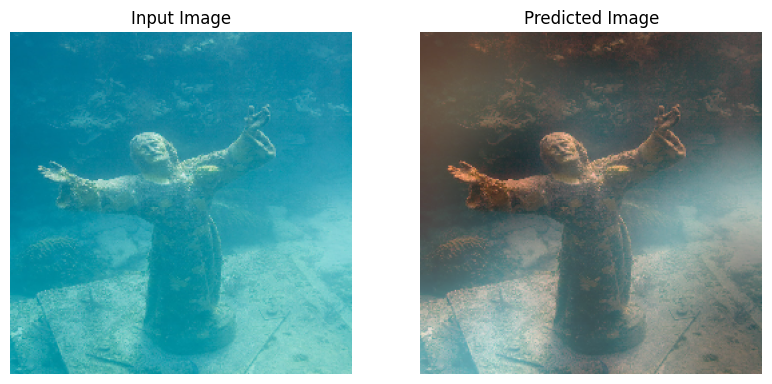

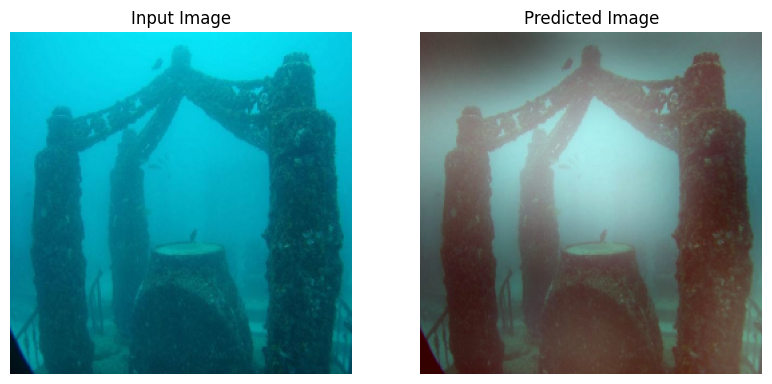

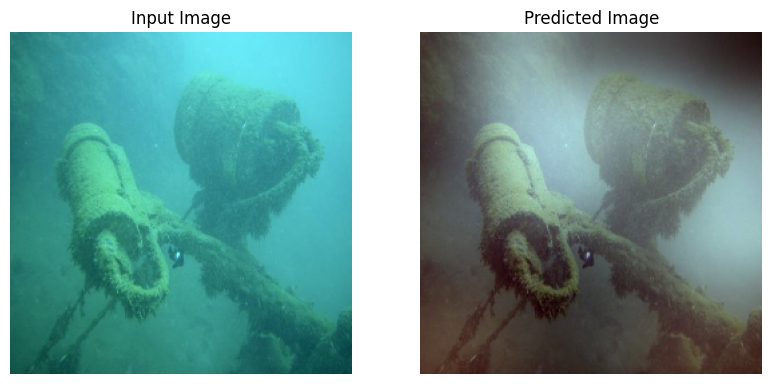

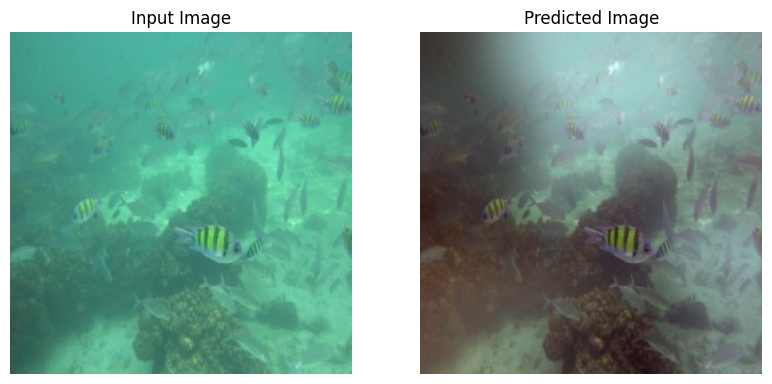

In [52]:
import os
import shutil
import matplotlib.pyplot as plt

def generate_chall_images(model, test_input, lap_up=True, wg_Ik=1.0, wg_gauss=0.0, drive_folder='/content/drive/MyDrive/data/evaluation'):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15, 15))

    hr_img = LaplacianUpscaling(prediction[0].numpy(), test_input[0].numpy(), wg_Ik, wg_gauss) if lap_up else prediction[0]

    display_list = [test_input[0], hr_img]
    title = ['Input Image', 'Predicted Image', 'Reference Image']

    for i in range(2):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # Getting the pixel values in the [0, 1] range to plot.
        plt.imshow(display_list[i]* 0.5 + 0.5)
        plt.axis('off')

    # Save the generated image directly in the Google Drive folder
    save_path = os.path.join(drive_folder, f'generated_image_{len(os.listdir(drive_folder))}.png')
    plt.savefig(save_path)
    plt.show()

# Assuming chall_test_ds is your dataset
img_list = list(chall_test_ds.take(10))

# Specify the Google Drive folder directly
drive_folder = '/content/drive/MyDrive/data/evaluation'

for img_pair in img_list:
    img = img_pair
    generate_chall_images(genG, img, lap_up=True, drive_folder=drive_folder)
